<a href="https://colab.research.google.com/github/adagora/project-02/blob/master/Week2_Stockpred_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import pandas as pd
import numpy as np
import datetime
import pandas_datareader.data as web
from pandas import Series, DataFrame

%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib as mpl
from math import ceil 
from sklearn import preprocessing 
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

In [2]:
start = datetime.datetime(1950, 3, 1)
end = datetime.datetime(2019, 9, 7)

df = web.DataReader("^GSPC", 'yahoo', start, end)
df.tail()

# dataset.shape # dataset.describe() # explore the data

,High,Low,Open,Close,Volume,Adj Close
Date,,,,,,
2019-08-30,2940.429932,2913.320068,2937.090088,2926.459961,3008450000,2926.459961
2019-09-03,2914.389893,2891.850098,2909.010010,2906.270020,3426790000,2906.270020
2019-09-04,2938.840088,2921.860107,2924.669922,2937.780029,3163260000,2937.780029
2019-09-05,2985.860107,2960.600098,2960.600098,2976.000000,3890700000,2976.000000
2019-09-06,2985.030029,2972.510010,2980.330078,2978.709961,3208280000,2978.709961


In [0]:
# Rolling Mean; MA, adjust downtrend/uptrend of stocks
close_px = df['Adj Close']
mavg = close_px.rolling(window=100).mean()

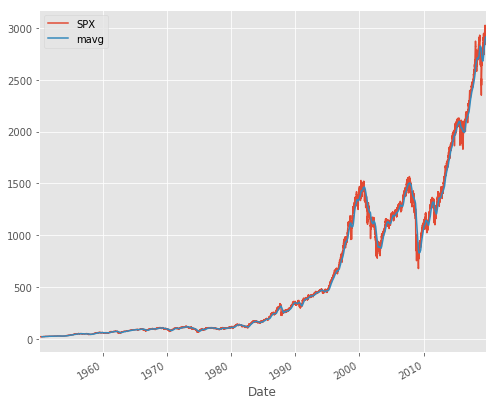

In [4]:
# Adjusting the size of matplotlib
mpl.rc('figure', figsize=(8, 7))
mpl.__version__
# Adjusting the style of matplotlib
style.use('ggplot')

close_px.plot(label='SPX')
mavg.plot(label='mavg')
plt.legend()

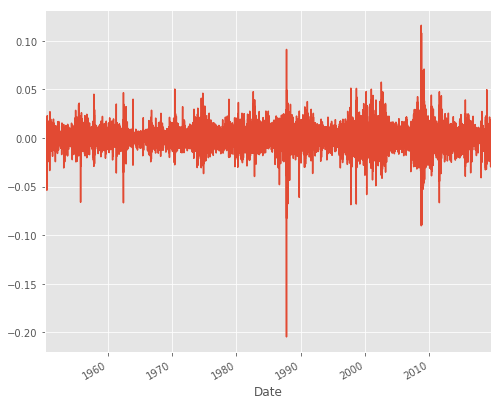

In [5]:
# Return Deviation — to determine risk and return  https://miro.medium.com/max/359/1*dx21tSoZSRX_YbDAgvR_JQ.png

rets = close_px / close_px.shift(1) - 1
rets.plot(label='return')


In [0]:
# Analysing your Competitors Stocks
dfcomp = web.DataReader(['^IXIC','^DJI', 'MSFT', 'AAPL'], 'yahoo', start=start, end=end) ['Adj Close']


In [0]:
# Correlation Analysis

retscomp = dfcomp.pct_change()
corr = retscomp.corr()



Text(0, 0.5, 'Returns AAPL')

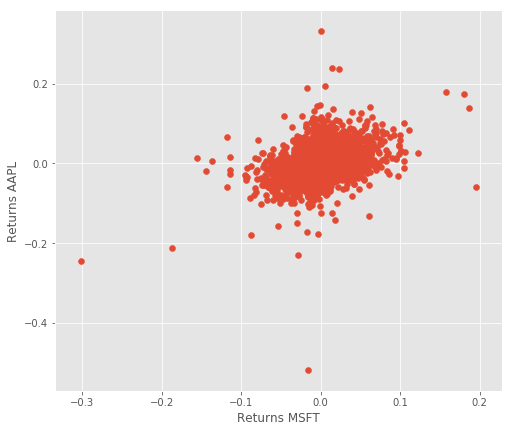

In [8]:
plt.scatter(retscomp.MSFT, retscomp.AAPL)
plt.xlabel('Returns MSFT')
plt.ylabel('Returns AAPL')

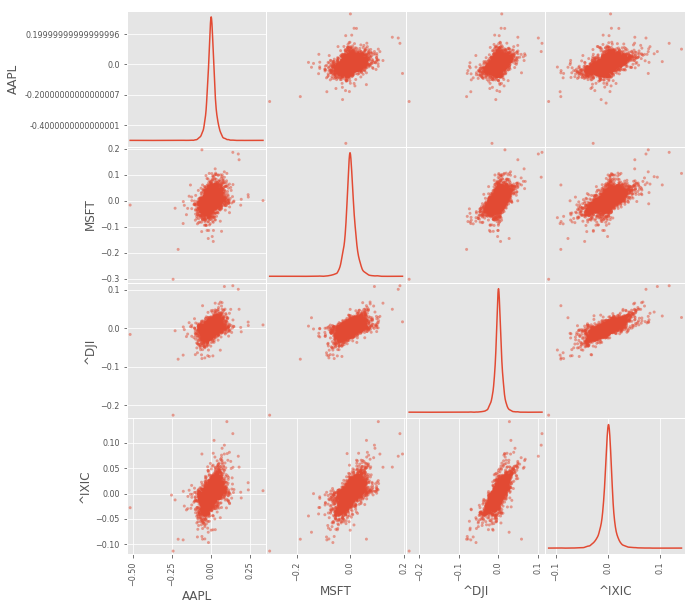

In [9]:
# Kernel Density Estimate (KDE)
pd.plotting.scatter_matrix(retscomp, diagonal='kde', figsize=(10, 10));

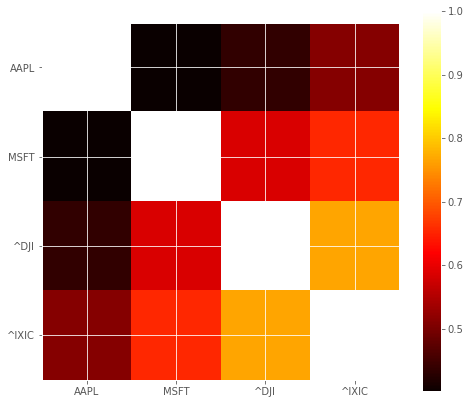

In [10]:
# heat maps to visualize the correlation ranges among the competing stocks. Notice that the lighter the color, the more correlated the two stocks are.
plt.imshow(corr, cmap='hot', interpolation='none')
plt.colorbar()
plt.xticks(range(len(corr)), corr.columns)
plt.yticks(range(len(corr)), corr.columns);

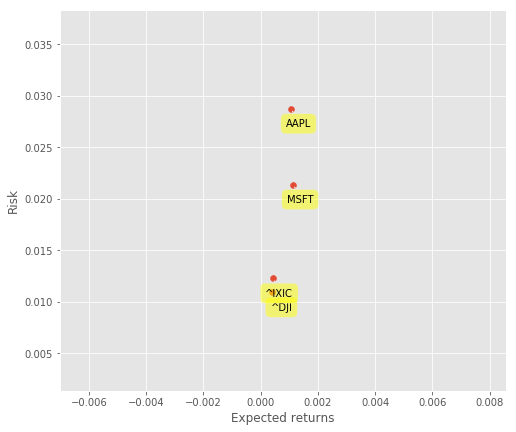

In [11]:
# Stocks Returns Rate and Risk
plt.scatter(retscomp.mean(), retscomp.std())
plt.xlabel('Expected returns')
plt.ylabel('Risk')
for label, x, y in zip(retscomp.columns, retscomp.mean(), retscomp.std()):
    plt.annotate(
        label, 
        xy = (x, y), xytext = (20, -20),
        textcoords = 'offset points', ha = 'right', va = 'bottom',
        bbox = dict(boxstyle = 'round,pad=0.5', fc = 'yellow', alpha = 0.5),
        arrowprops = dict(arrowstyle = '->', connectionstyle = 'arc3,rad=0'))


In [0]:
#Engineering some features for the algorithms: High Low Percentage and Percentage Change
dfreg = df.loc[:,['Adj Close','Volume']]
dfreg['HL_PCT'] = (df['High'] - df['Low']) / df['Close'] * 100.0
dfreg['PCT_change'] = (df['Close'] - df['Open']) / df['Open'] * 100.0

In [0]:
##PREPROCESSING AND DATA VALIDATION
#Drop missing value
dfreg.fillna(value=-99999, inplace = True)
dfreg.dropna(inplace=True) #CORRECTION: ADDED NEW SO X AND y ARE EQUAL

#we want to separate 1% of the data to forecast
forecast_out = int(ceil(.01 * len(dfreg))) #CORRECTION: was called incorrectly in former code below
#FORMERCODE forecast_out = int(math.ceil(0.01 * len(dfreg)))


In [0]:
#separating the label here, we want to predict the AdjClose
forecast_col = 'Adj Close'
dfreg['label'] = dfreg[forecast_col].shift(-forecast_out)
X = np.array(dfreg.drop(['label'], 1))

In [15]:
#Scale the X so that everyone can have the same distribution for linear regression
X = preprocessing.scale(X)

#Finally we want to find Data Series of late X and early X (train) for model generation and evaluation
X_lately = X[-forecast_out:]
X = X[:-forecast_out]

#Separate label and identify it as y
y = np.array(dfreg['label'])
y = y[:-forecast_out]




/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:172: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn("Numerical issues were encountered "


In [0]:
# Train and test split. DEFINING X_train before we use it
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [17]:
# Linear regression
clfreg = LinearRegression(n_jobs=-1)
clfreg.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)

In [18]:
# Quadratic Regression 2
clfpoly2 = make_pipeline(PolynomialFeatures(2), Ridge())
clfpoly2.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('polynomialfeatures',
                 PolynomialFeatures(degree=2, include_bias=True,
                                    interaction_only=False, order='C')),
                ('ridge',
                 Ridge(alpha=1.0, copy_X=True, fit_intercept=True,
                       max_iter=None, normalize=False, random_state=None,
                       solver='auto', tol=0.001))],
         verbose=False)

In [19]:
# Quadratic Regression 3
clfpoly3 = make_pipeline(PolynomialFeatures(3), Ridge())
clfpoly3.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('polynomialfeatures',
                 PolynomialFeatures(degree=3, include_bias=True,
                                    interaction_only=False, order='C')),
                ('ridge',
                 Ridge(alpha=1.0, copy_X=True, fit_intercept=True,
                       max_iter=None, normalize=False, random_state=None,
                       solver='auto', tol=0.001))],
         verbose=False)

In [20]:
#KNN regression
clfknn = KNeighborsRegressor(n_neighbors=2)
clfknn.fit(X_train, y_train)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=2, p=2,
                    weights='uniform')

In [21]:
#let's evaluate all of the models against eachother
confidencereg = clfreg.score(X_test,y_test)
confidencepoly2 = clfpoly2.score(X_test, y_test)
confidencepoly3 = clfpoly3.score(X_test,y_test)
confidenceknn = clfknn.score(X_test, y_test)

# results
('The linear regression confidence is', confidencereg)
('The quadratic regression 2 confidence is ', confidencepoly2)
('The quadratic regression 3 confidence is ', confidencepoly3)
('The knn regression confidence is ', confidenceknn)


('The knn regression confidence is ', 0.9818032801392871)

In [0]:
#printing some of the stocks forecasts
forecast_set_reg = clfreg.predict(X_lately)
forecast_set_poly2 = clfpoly2.predict(X_lately) 
forecast_set_poly3 = clfpoly3.predict(X_lately)
forecast_set_knn = clfknn.predict(X_lately)
dfreg['Forecast'] = np.nan

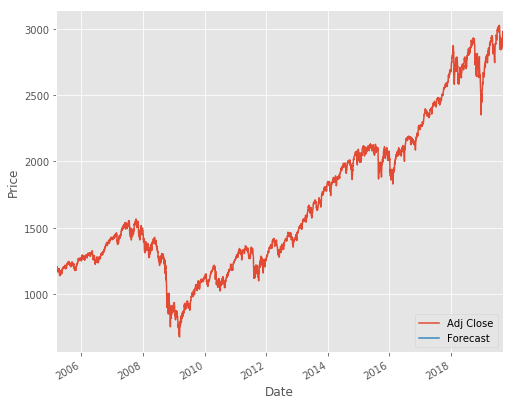

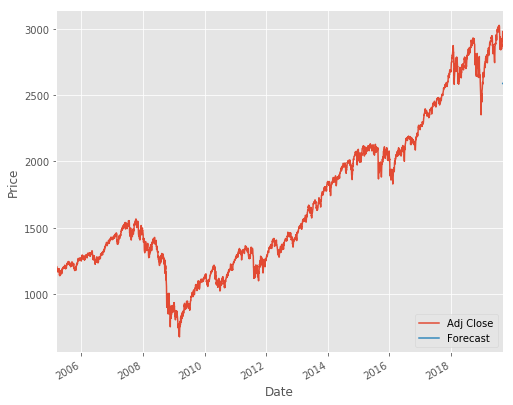

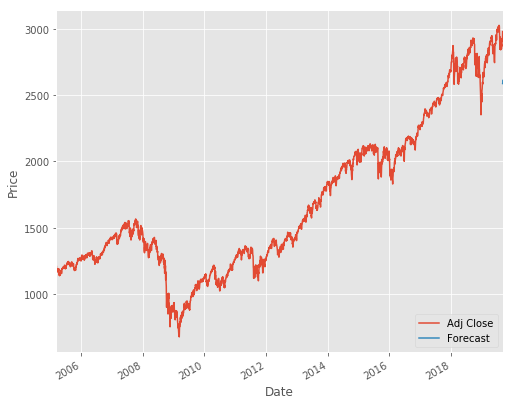

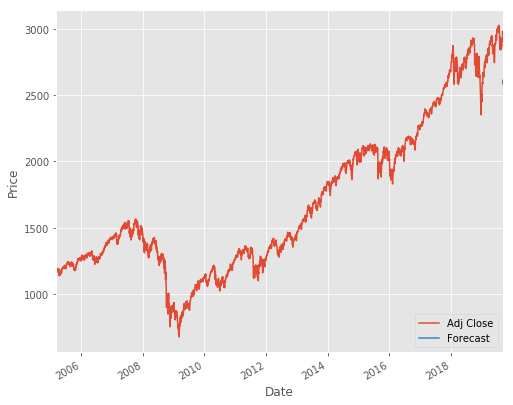

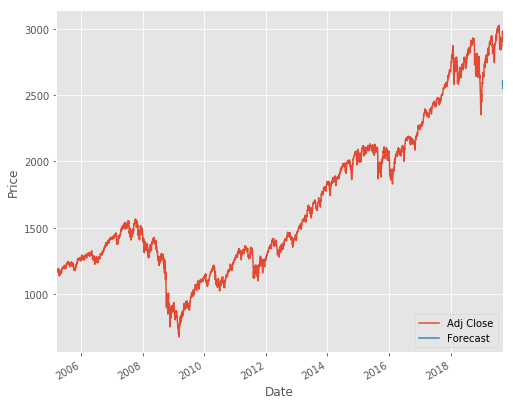

...

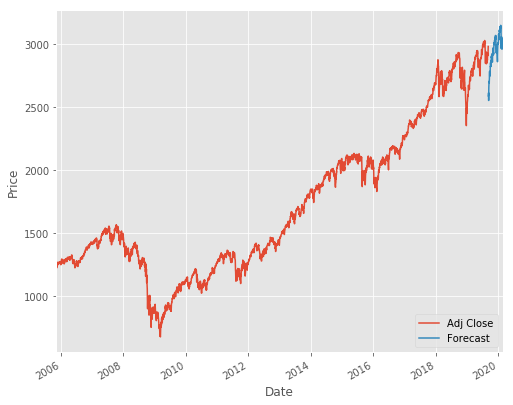

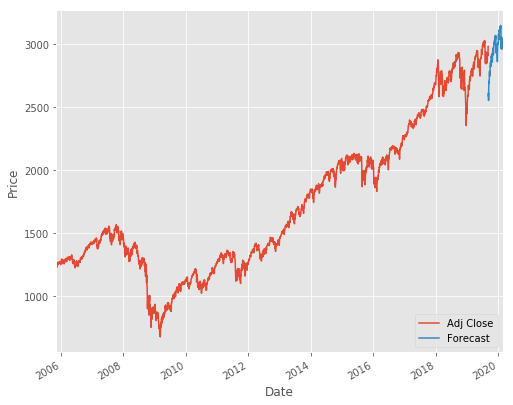

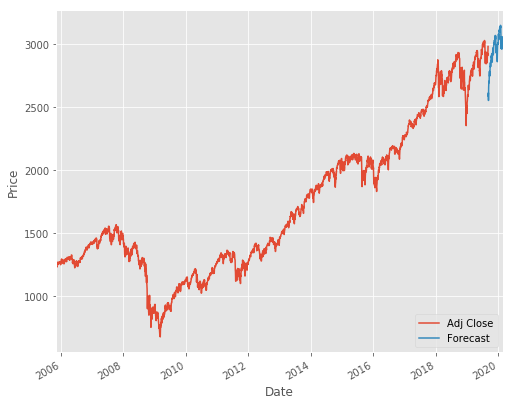

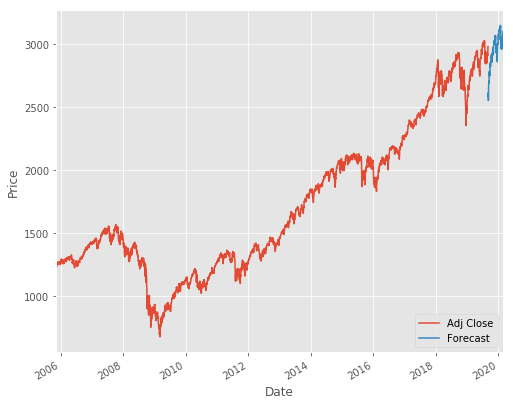

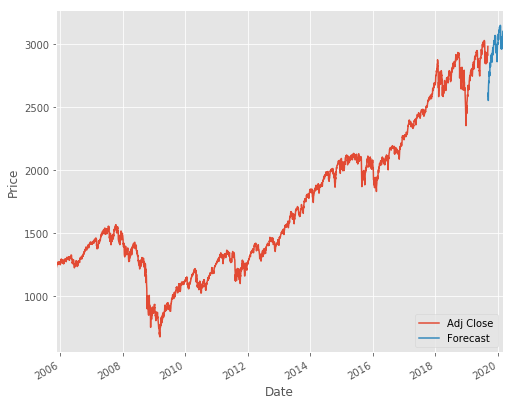

In [23]:
#Results

#Plotting the forecast with existing historical data so we can compare it to future price movements
last_date = dfreg.iloc[-1].name
last_unix = last_date
next_unix = last_unix + datetime.timedelta(days=1)

for i in forecast_set_reg:
    next_date = next_unix
    next_unix += datetime.timedelta(days=1)
    dfreg.loc[next_date] = [np.nan for _ in range(len(dfreg.columns)-1)]+[i]

    dfreg['Adj Close'].tail(3650).plot()
    dfreg['Forecast'].tail(730).plot()
    plt.legend(loc=4)
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()

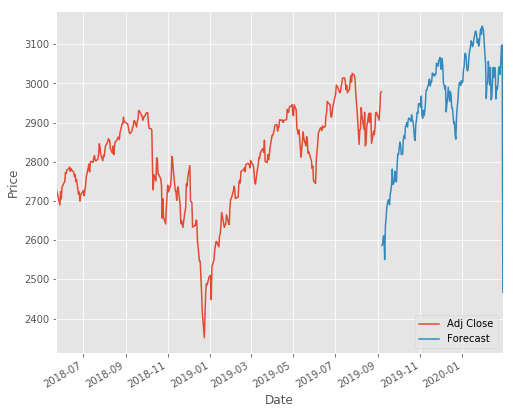

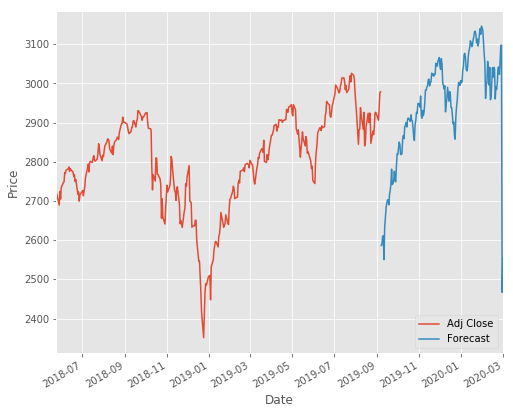

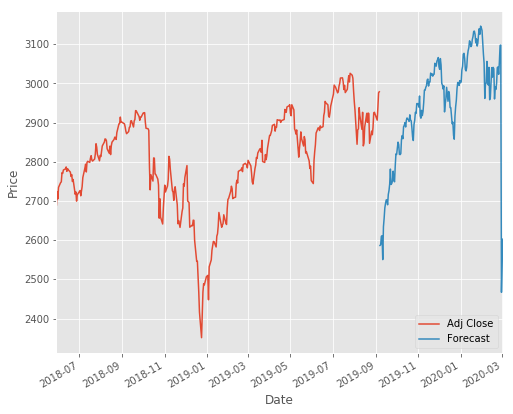

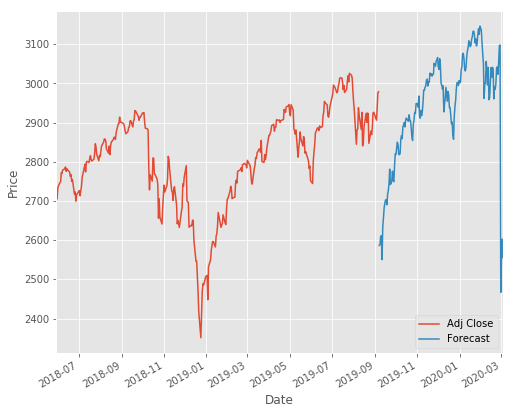

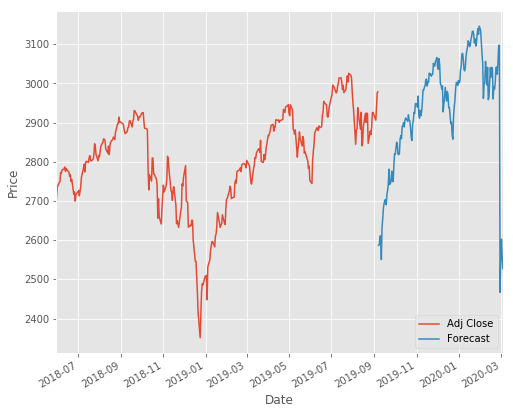

...

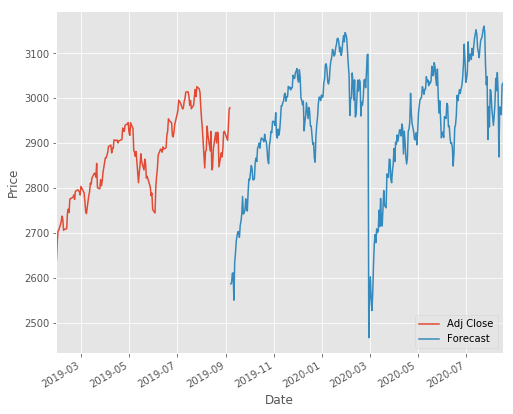

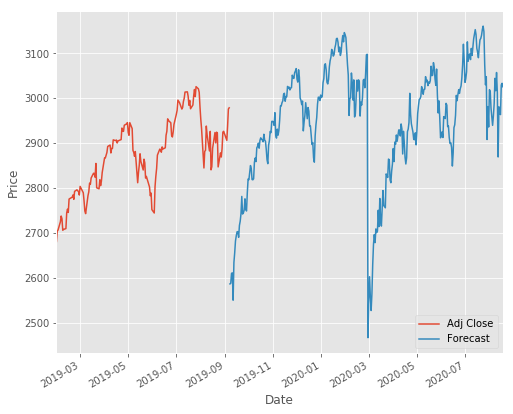

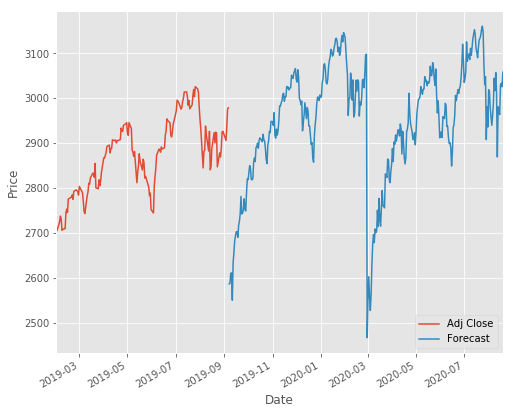

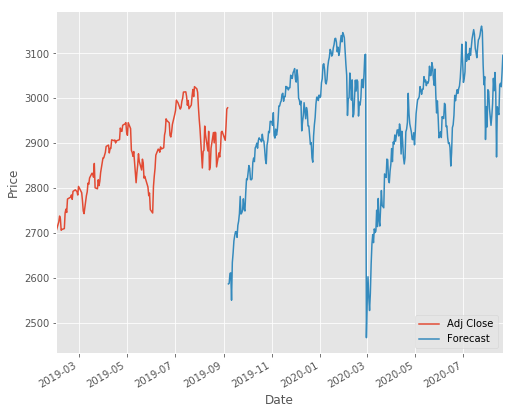

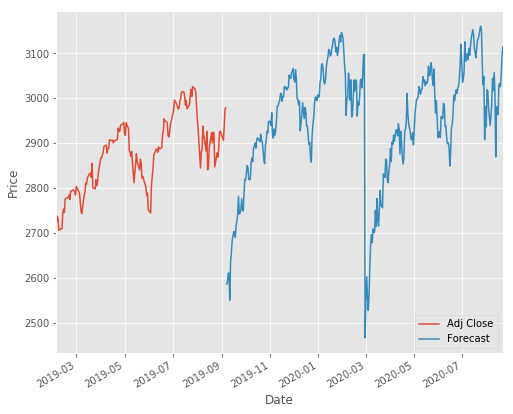

In [24]:
for i in forecast_set_poly2: 
    next_date = next_unix
    next_unix += datetime.timedelta(days=1)
    dfreg.loc[next_date] = [np.nan for _ in range(len(dfreg.columns)-1)]+[i]

    dfreg['Adj Close'].tail(500).plot()
    dfreg['Forecast'].tail(500).plot()
    plt.legend(loc=4)
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()

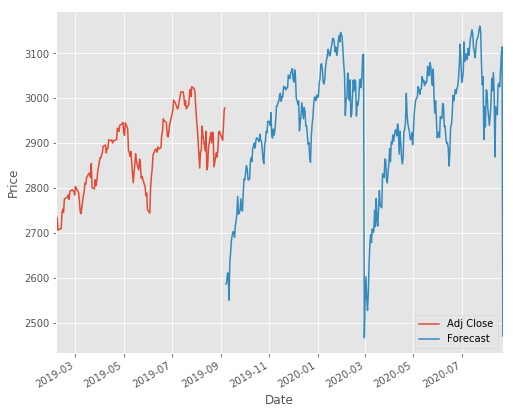

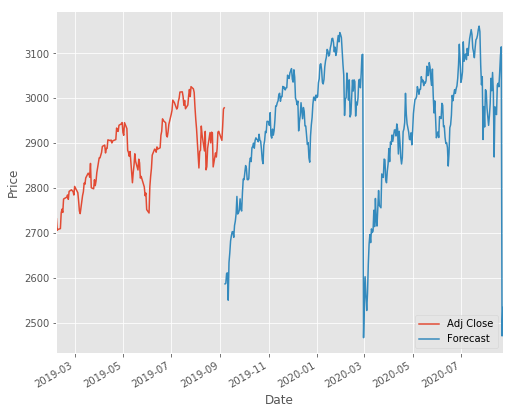

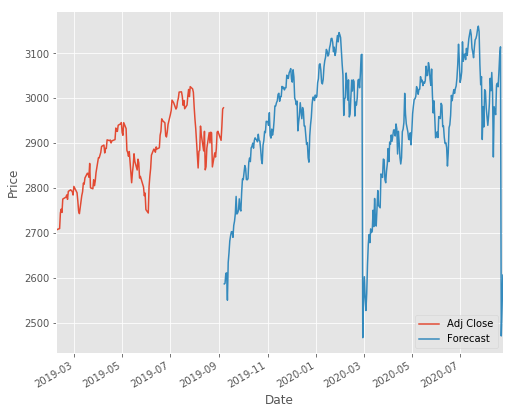

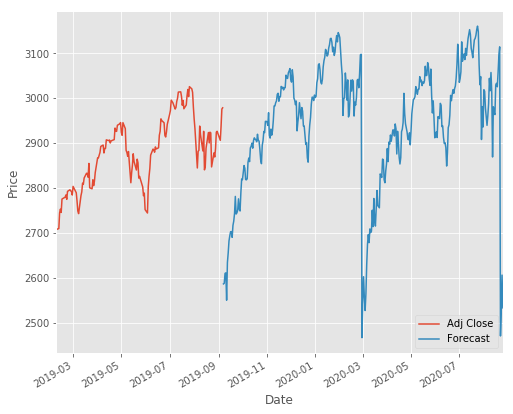

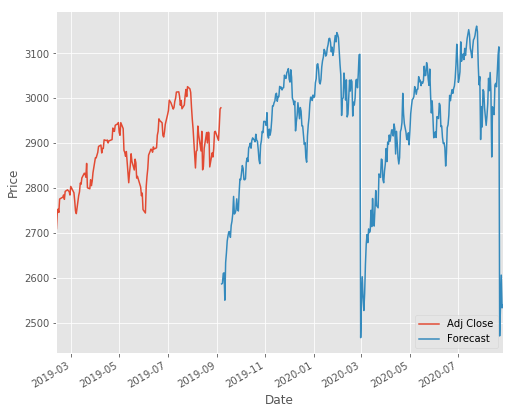

...

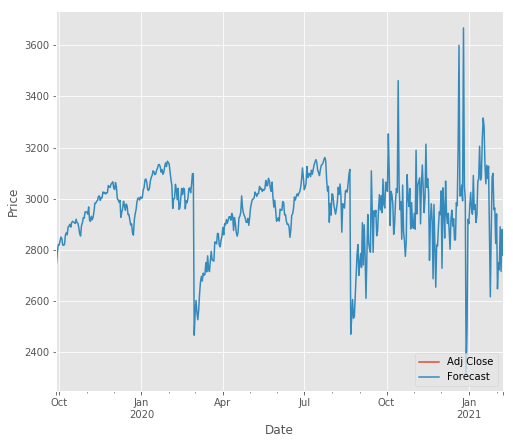

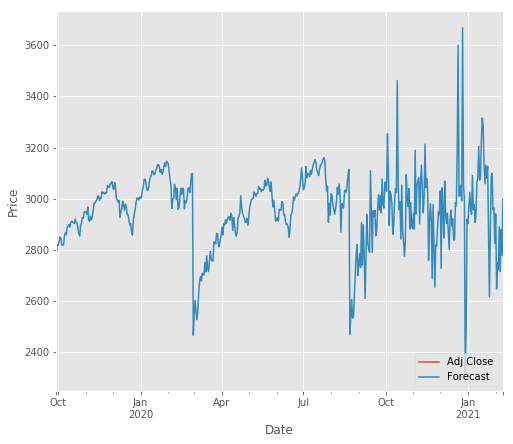

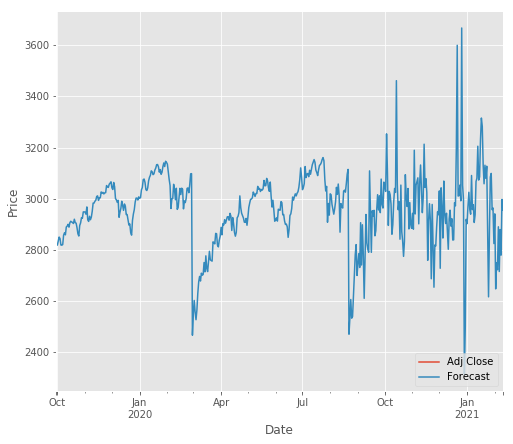

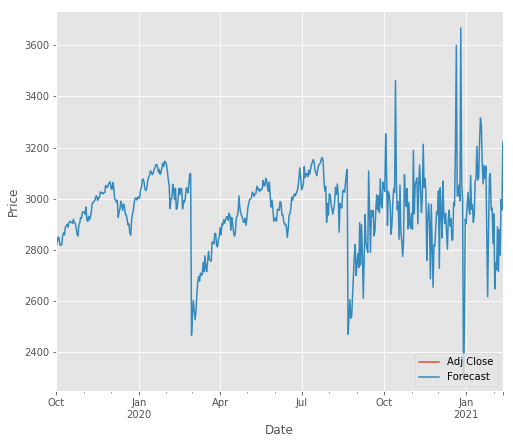

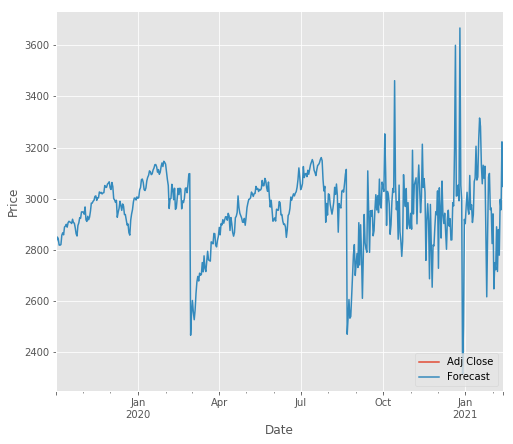

In [25]:
for i in forecast_set_poly3:
    next_date = next_unix
    next_unix += datetime.timedelta(days=1)
    dfreg.loc[next_date] = [np.nan for _ in range(len(dfreg.columns)-1)]+[i]

    dfreg['Adj Close'].tail(500).plot()
    dfreg['Forecast'].tail(500).plot()
    plt.legend(loc=4)
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()

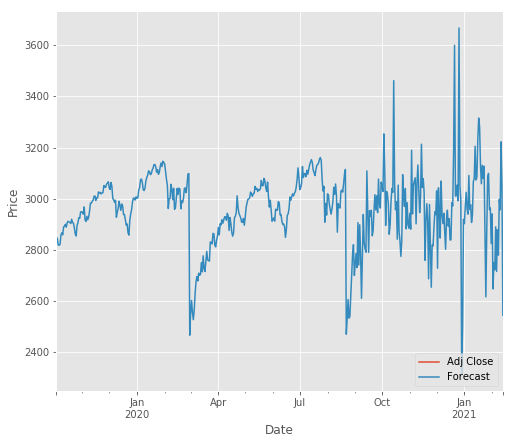

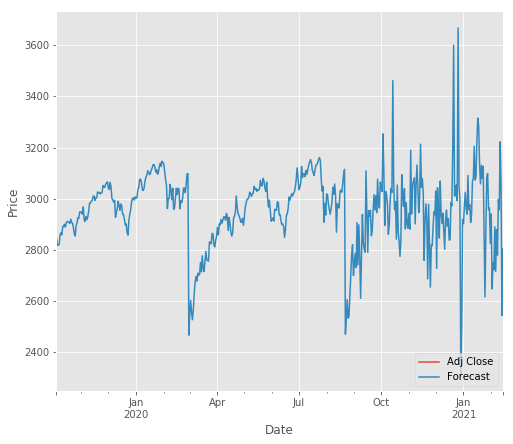

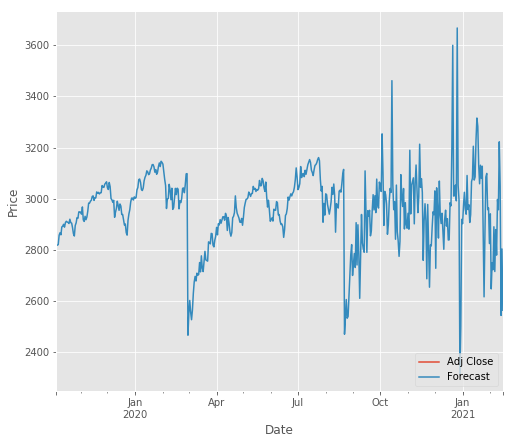

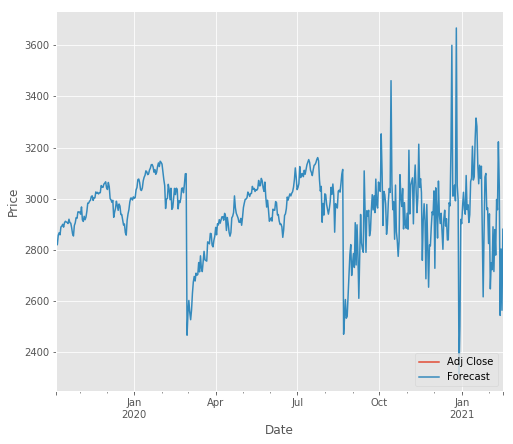

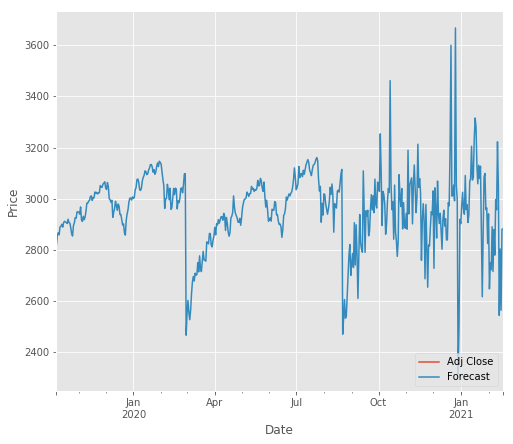

...

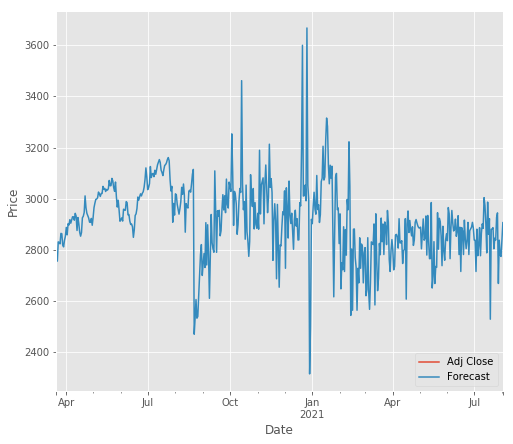

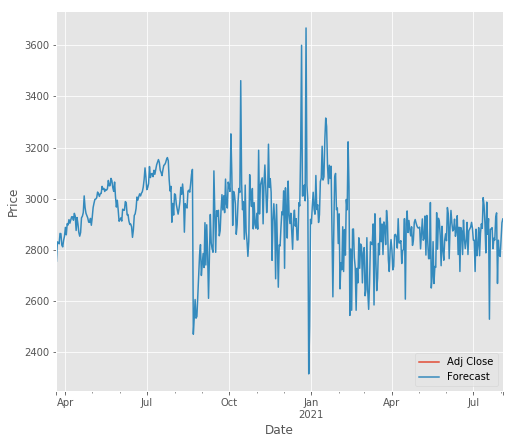

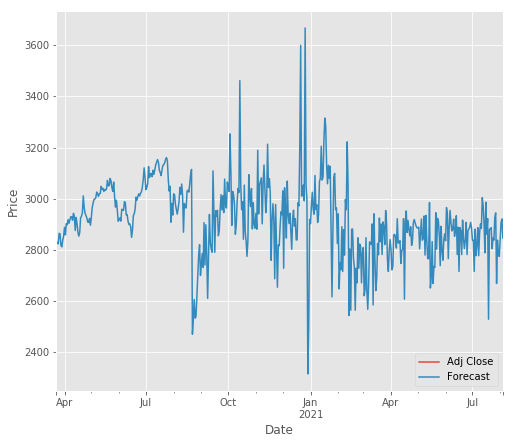

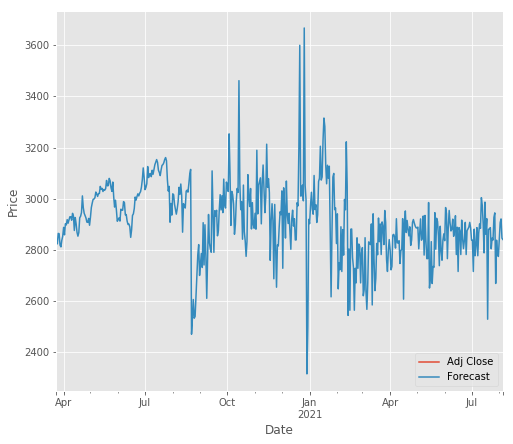

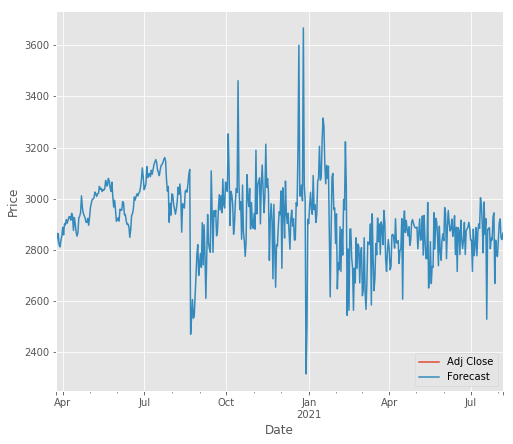

In [26]:
for i in forecast_set_knn:
    next_date = next_unix
    next_unix += datetime.timedelta(days=1)
    dfreg.loc[next_date] = [np.nan for _ in range(len(dfreg.columns)-1)]+[i]

    dfreg['Adj Close'].tail(500).plot()
    dfreg['Forecast'].tail(500).plot()
    plt.legend(loc=4)
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.show()

In [27]:
## LSTM MODEL work ##

window_size = 32 # Allow us to look at 32 days into the past
# Prepare the data so that we have 32 day windows and predict what the next day should be
# Get indices of access for the data
num_samples = len(df) - window_size
indices = np.arange(num_samples).astype(np.int)[:,None] + np.arange(window_size + 1).astype(np.int)

data = df['Adj Close'].values[indices] # Create the 2D matrix of training samples

X = data[:,:-1] # Each row represents 32 days in the past
y = data[:,-1] # Each output value represents the 33rd day

# Train and test split
split_fraction = 0.8
ind_split = int(split_fraction * num_samples)
X_train = X[:ind_split]
y_train = y[:ind_split]
X_test = X[ind_split:]
y_test = y[ind_split:]

import sklearn
from sklearn.linear_model import Ridge
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Conv1D, LSTM, Dense
from keras.callbacks import LearningRateScheduler
from tensorflow.keras.losses import Huber
from keras.optimizers import SGD

# Model #3 - Using RNNs
keras_model = Sequential([
  Conv1D(filters=128, kernel_size=5, input_shape=(window_size, 1), strides=1, padding="causal", activation="tanh"),
  Conv1D(filters=128, kernel_size=5, strides=1, padding="causal", activation="tanh"),
  LSTM(128, return_sequences=True),
  LSTM(128),
  Dense(64, activation="tanh"),
  Dense(64, activation="tanh"),
  Dense(1)
])

keras_model.summary()

Using TensorFlow backend.


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 32, 128)           768       
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 32, 128)           82048     
_________________________________________________________________
lstm_1 (LSTM)                (None, 32, 128)           131584    
_________________________________________________________________
lstm_2 (LSTM)                (None, 128)               131584    
_________________________________________________________________
dense_1 (Dense)              (None, 64)                8256      
_________________________________________________________________
dense_2 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_3 (Dense)              (None, 1)                

In [28]:
# First figure out the right learning rate
lr_schedule = LearningRateScheduler(lambda epoch: 1e-8 * 10**(epoch / 20))
optimizer = SGD(lr=1e-8, momentum=0.9)
keras_model.compile(loss=Huber(),
                    optimizer=optimizer,
                    metrics=["mae"])
# Scale the data due to LSTM units
scaler = MinMaxScaler(feature_range=(-1, 1))
data_transform = scaler.fit_transform(df['Adj Close'].values[:,None])
data_transform = data_transform[indices]
X2 = data_transform[:,:-1]
y2 = data_transform[:,-1]
X_train_reshape = X2[:ind_split]
y_train_reshape = y2[:ind_split]
X_test_reshape = X2[ind_split:]
y_test_reshape = y2[ind_split:]

In [29]:
history = keras_model.fit(X_train_reshape, y_train_reshape, batch_size=256, epochs=250, callbacks=[lr_schedule], validation_data=(X_test_reshape, y_test_reshape))

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 13969 samples, validate on 3493 samples
Epoch 1/250
13969/13969 [==============================] - 13s 958us/step - loss: 0.3833 - mean_absolute_error: 0.8337 - val_loss: 0.0884 - val_mean_absolute_error: 0.3311
Epoch 2/250
13969/13969 [==============================] - 5s 382us/step - loss: 0.3832 - mean_absolute_error: 0.8337 - val_loss: 0.0884 - val_mean_absolute_error: 0.3311
Epoch 3/250
13969/13969 [==============================] - 5s 380us/step - loss: 0.3832 - mean_absolute_error: 0.8336 - val_loss: 0.0884 - val_mean_absolute_error: 0.3311
Epoch 4/250
13969/13969 [==============================] - 5s 384us/step - loss: 0.3831 - mean_absolute_error: 0.8335 - val_loss: 0.0884 - val_mean_absolute_error: 0.3311
Epoch 5/250
13969/13969 [==============================] - 5s 385us/step - loss: 0.3831 - mean_absolute_error: 0.8334 - val_loss: 0.0884 - val_mean_absolute_error: 0.3311

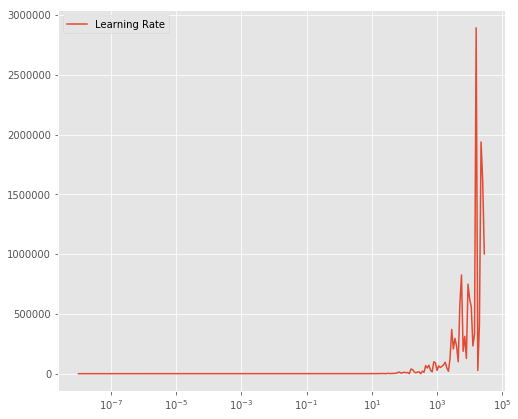

In [30]:
plt.semilogx(history.history['lr'], history.history['val_loss'])
plt.legend(['Learning Rate', 'Validation Loss'])

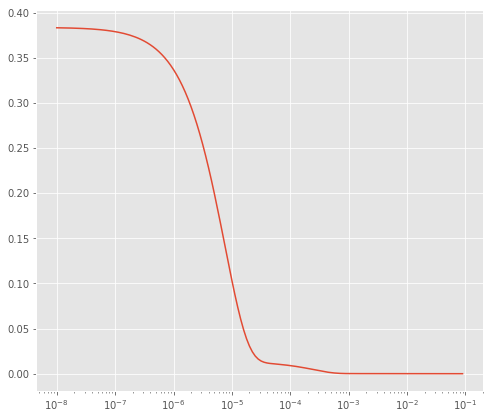

In [31]:
plt.semilogx(history.history['lr'][:140], history.history['loss'][:140])

In [32]:
# Observing the above graph, 0.05 seems to be the best learning rate WHAT I CHOSSED IT
keras_model = Sequential([
  Conv1D(filters=128, kernel_size=5, input_shape=(window_size, 1), strides=1, padding="causal", activation="tanh"),
  Conv1D(filters=128, kernel_size=5, strides=1, padding="causal", activation="tanh"),
  LSTM(128, return_sequences=True),
  LSTM(128),
  Dense(64, activation="tanh"),
  Dense(64, activation="tanh"),
  Dense(1)
])


optimizer = SGD(lr=0.1, momentum=0.9)
keras_model.compile(loss=Huber(),
                    optimizer=optimizer,
                    metrics=["mae"])
history = keras_model.fit(X_train_reshape, y_train_reshape, batch_size=256, epochs=250, validation_data=(X_test_reshape, y_test_reshape))

Train on 13969 samples, validate on 3493 samples
Epoch 1/250
13969/13969 [==============================] - 7s 479us/step - loss: 0.0369 - mean_absolute_error: 0.1890 - val_loss: 0.0087 - val_mean_absolute_error: 0.1217
Epoch 2/250
13969/13969 [==============================] - 5s 379us/step - loss: 4.1714e-04 - mean_absolute_error: 0.0212 - val_loss: 0.0084 - val_mean_absolute_error: 0.0766
Epoch 3/250
13969/13969 [==============================] - 5s 383us/step - loss: 1.3414e-04 - mean_absolute_error: 0.0123 - val_loss: 0.0092 - val_mean_absolute_error: 0.0811
Epoch 4/250
13969/13969 [==============================] - 5s 388us/step - loss: 9.7143e-05 - mean_absolute_error: 0.0102 - val_loss: 0.0101 - val_mean_absolute_error: 0.0859
Epoch 5/250
13969/13969 [==============================] - 5s 385us/step - loss: 7.8557e-05 - mean_absolute_error: 0.0088 - val_loss: 0.0111 - val_mean_absolute_error: 0.0908
Epoch 6/250
13969/13969 [==============================] - 5s 382us/step - loss:

In [0]:
# reverse the normalization 
y_pred_train_keras = scaler.inverse_transform(keras_model.predict(X_train_reshape, batch_size=256))
y_pred_keras = scaler.inverse_transform(keras_model.predict(X_test_reshape, batch_size=256))

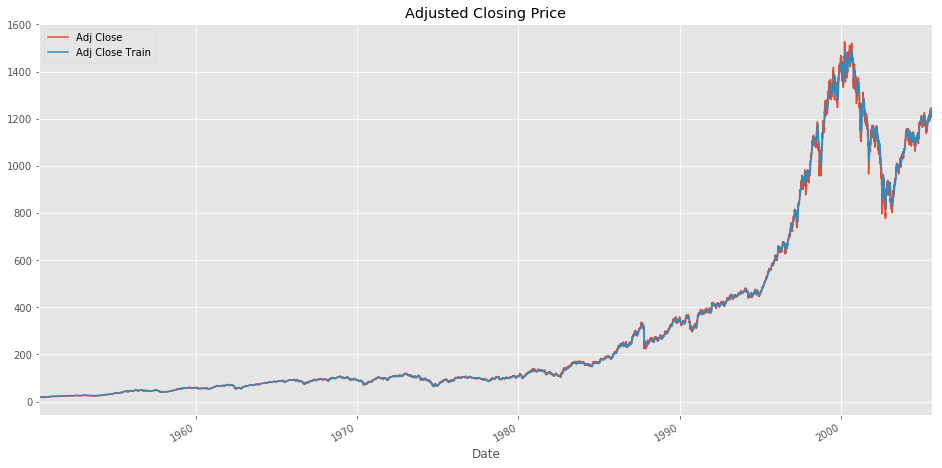

In [34]:
# Plot what it looks like for the training data
df_keras = df.copy()
df_keras.drop(['Open', 'High', 'Low', 'Close', 'Volume'], axis=1, inplace=True)
df_keras = df_keras.iloc[window_size:ind_split] # Past 32 days we don't know yet
df_keras['Adj Close Train'] = y_pred_train_keras[:-window_size]
df_keras.plot(label='SPX', figsize=(16,8), title='Adjusted Closing Price', grid=True)

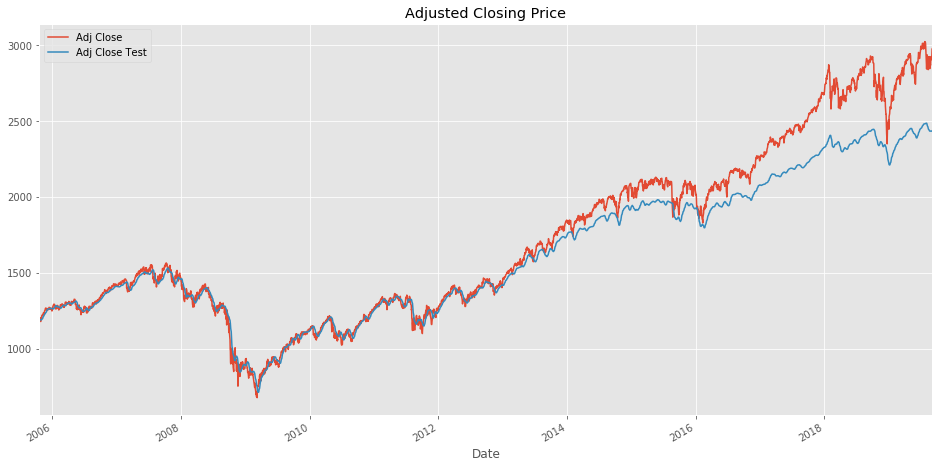

In [35]:
# Same for the test
df_keras = df.copy()
df_keras.drop(['Open', 'High', 'Low', 'Close', 'Volume'], axis=1, inplace=True)
df_keras = df_keras.iloc[ind_split+window_size:] # Past 32 days we don't know yet
df_keras['Adj Close Test'] = y_pred_keras
df_keras.plot(label='SPX', figsize=(16,8), title='Adjusted Closing Price', grid=True)

In [0]:
num_days = 50 # Let's try and forecase the next 10 days or two years

# Get the last window_size (32) days
data_seed = df['Adj Close'].values[-window_size:][None]
# Get the normalized data as well for the neural network
data_seed_norm = scaler.transform(data_seed)
input_values = {"keras": data_seed_norm.copy()}
values = {"ridge": [], "gb": [], "keras": []}
for i in range(num_days): # For each day...
    # Predict the next price given the previous N prices
    values["keras"].append(keras_model.predict(input_values["keras"][...,None])[0][0])

    # Dump the oldest price and put the newest price at the end
    for v in input_values:
        val = input_values[v]
        val = np.insert(val, -1, values[v][-1], axis=1)
        val = np.delete(val, 0, axis=1)
        input_values[v] = val.copy()

# Convert all to NumPy arrays
for v in input_values:
    values[v] = np.array(values[v])

# Unnormalize prices from NN approach
values["keras"] = scaler.inverse_transform(values["keras"][None])[0]

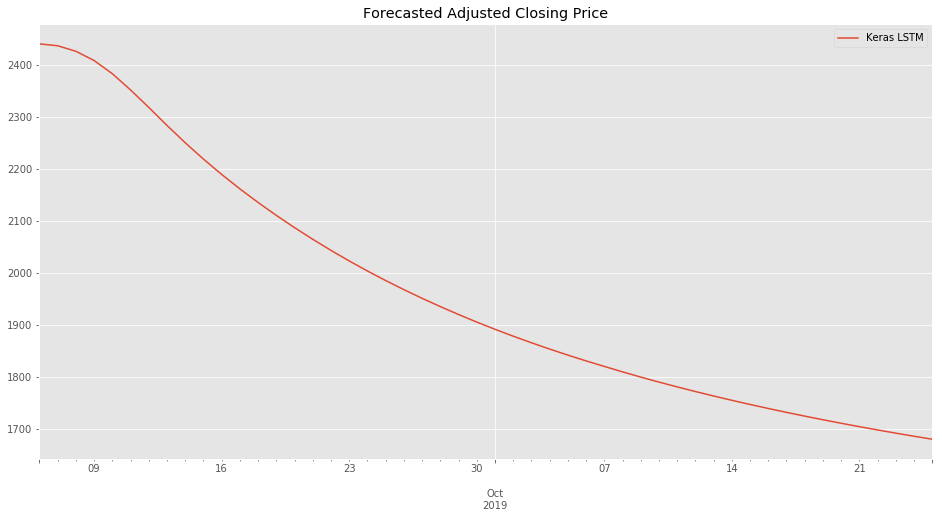

In [39]:
from datetime import timedelta, datetime
last_date = datetime.strftime(df.index[-1], '%Y-%m-%d')
df_forecast = pd.DataFrame()
df_forecast["Keras LSTM"] = values["keras"]
df_forecast.index = pd.date_range(start=last_date, periods=num_days)
df_forecast.plot(label='SPX', figsize=(16,8), title='Forecasted Adjusted Closing Price', grid=True)